## Imports

In [1]:
%matplotlib inline
from utils import *
from plotting import *
from models import *

## Load Dataset (e.g., Animal-AI_v3)

In [2]:
dataset, pose = load_dataset('dataset_animalai3', file_format='.npy', load_pose=True, pose_filename='pose.npy')

In [3]:
position = pose[:,:2]
orientation = pose[:,2]

In [4]:
print(dataset.shape, position.shape, orientation.shape)

(20000, 84, 84, 3) (20000, 2) (20000,)


In [5]:
'''
n_samples = 20000
dataset = dataset[:n_samples, :]
position = position[:n_samples, :]
orientation = orientation[:n_samples]
'''

'\nn_samples = 20000\ndataset = dataset[:n_samples, :]\nposition = position[:n_samples, :]\norientation = orientation[:n_samples]\n'

### Intrinsic dimensionality

In [6]:
dataset_flatten = dataset.reshape((dataset.shape[0], int(dataset.shape[1]*dataset.shape[2]*dataset.shape[3])))

In [7]:
D = intrinsic_dimensionality(dataset_flatten, method='PCA')

In [8]:
print(D)

19


### Occupancy map

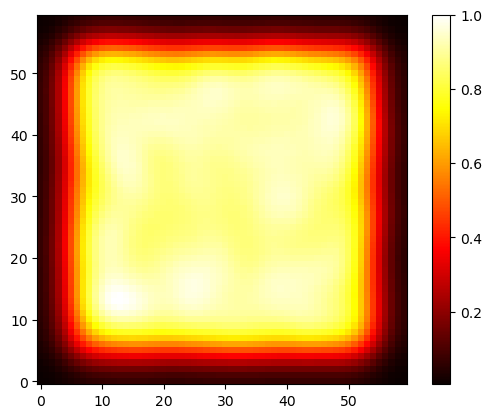

In [6]:
occ_map = occupancy_map(position, filter_width=3, padding=True, n_bins_padding=5)
plt.imshow(occ_map, cmap='hot', origin='lower')
plt.colorbar()

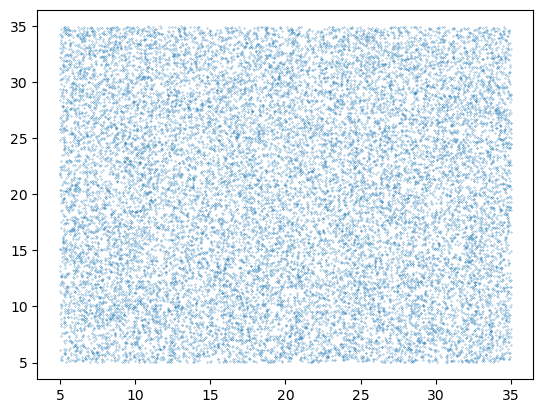

In [7]:
plt.scatter(position[:,0], position[:,1], s=.05)

## Autoencoder network

In [25]:
model = Conv_AE(n_hidden=500, hidden_regularization=True)

In [26]:
train_loader = create_dataloader(dataset, batch_size=256, reshuffle_after_epoch=True)

In [27]:
history, embeddings_epoch = train_autoencoder(model, train_loader, num_epochs=1000, learning_rate=1e-4, alpha=1e4, beta=1e0) #alpha=2e3

Epoch 68/1000, Loss: 0.0102: 100%|█████████████████████████████████████████████████████| 79/79 [00:02<00:00, 39.18it/s]


Epoch 136/1000, Loss: 0.0074: 100%|████████████████████████████████████████████████████| 79/79 [00:02<00:00, 38.71it/s]


Epoch 204/1000, Loss: 0.0063: 100%|████████████████████████████████████████████████████| 79/79 [00:02<00:00, 38.31it/s]


Epoch 272/1000, Loss: 0.0054: 100%|████████████████████████████████████████████████████| 79/79 [00:01<00:00, 41.52it/s]


Epoch 340/1000, Loss: 0.0050: 100%|████████████████████████████████████████████████████| 79/79 [00:01<00:00, 43.35it/s]


Epoch 408/1000, Loss: 0.0048: 100%|████████████████████████████████████████████████████| 79/79 [00:02<00:00, 39.49it/s]


Epoch 476/1000, Loss: 0.0047: 100%|████████████████████████████████████████████████████| 79/79 [00:02<00:00, 39.28it/s]


Epoch 544/1000, Loss: 0.0044: 100%|████████████████████████████████████████████████████| 79/79 [00:02<00:00, 37.80it/s]


Epoch 612/1000, Loss: 0.0044: 100%|████████████████████████████████████████████████████| 79/79 [00:01<00:00, 40.40it/s]


Epoch 680/1000, Loss: 0.0042: 100%|████████████████████████████████████████████████████| 79/79 [00:02<00:00, 37.19it/s]


Epoch 748/1000, Loss: 0.0042: 100%|████████████████████████████████████████████████████| 79/79 [00:01<00:00, 39.77it/s]


Epoch 816/1000, Loss: 0.0042: 100%|████████████████████████████████████████████████████| 79/79 [00:01<00:00, 42.26it/s]


Epoch 884/1000, Loss: 0.0041: 100%|████████████████████████████████████████████████████| 79/79 [00:02<00:00, 32.28it/s]


Epoch 952/1000, Loss: 0.0040: 100%|████████████████████████████████████████████████████| 79/79 [00:02<00:00, 39.00it/s]


Epoch 1000/1000, Loss: 0.0040: 100%|███████████████████████████████████████████████████| 79/79 [00:02<00:00, 34.98it/s]


In [ ]:
embeddings_epoch.shape

In [67]:
torch.save(model.state_dict(), 'saved_models/AE_white_sparse_500.pth')

In [57]:
model = Conv_AE(n_hidden=1000, hidden_regularization=True).to('cuda')
model.load_state_dict(torch.load('saved_models/AE_ortho.pth'))

<All keys matched successfully>

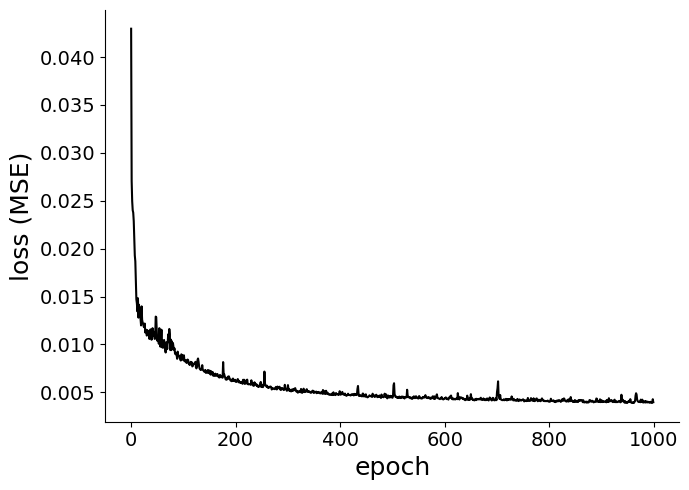

In [34]:
plt.figure(figsize=(7,5))
plt.plot(history, color='black')
plt.xlabel('epoch', fontsize=18)
plt.ylabel('loss (MSE)', fontsize=18)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
sb.despine()
plt.tight_layout()

plt.savefig('plots/loss.png', dpi=600)
plt.show()

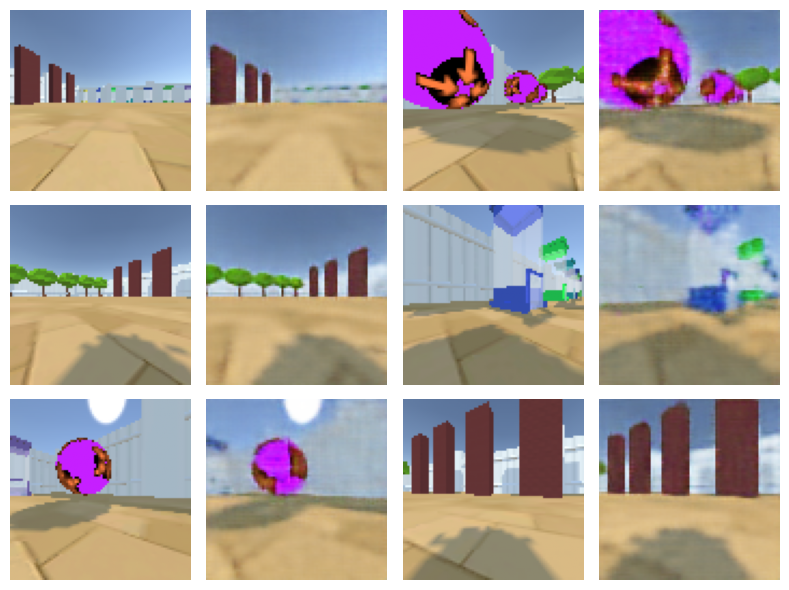

In [55]:
plt.figure(figsize=(8,6))

indxs = np.random.randint(0, 1000, 6)

for i in range(12):
    plt.subplot(3,4,i+1)
    if i%2==0:
        plt.imshow(dataset[indxs[int(i/2)]])
    else:
        plt.imshow(predict(dataset[indxs[int(i/2)]], model))
    plt.axis('off')

plt.tight_layout()
plt.savefig('plots/reconstructed_imgs.png', dpi=600)
plt.show()

In [58]:
embeddings = get_latent_vectors(dataset, model)

In [57]:
#np.save('embeddingsTroughTime_hidden200_samples20K_batch128_orth1e3_lr1e-4_epochs1000.npy', embeddings_epoch)

In [58]:
#np.save('lossTroughTime_hidden200_samples20K_batch128_orth1e3_lr1e-4_epochs1000.npy', np.array(history))

In [8]:
#embeddings = np.load('results/embeddings_hidden200_samples10K_bacth128_orth1e3_lr1e-4_epochs600.npy')

In [8]:
embeddings_epoch = np.load('results/embeddingsTroughTime_hidden200_samples20K_batch128_orth1e3_lr1e-4_epochs1000.npy')
embeddings = embeddings_epoch[-1]

In [9]:
embeddings_epoch.shape

(1001, 20000, 200)

### Pairwise activity correlation

#### SSCP matrix

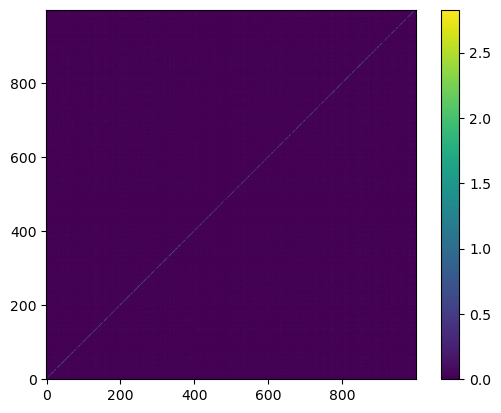

In [59]:
sscp = np.dot(embeddings.T, embeddings)
plt.imshow(sscp, origin='lower')
plt.colorbar()
plt.show()

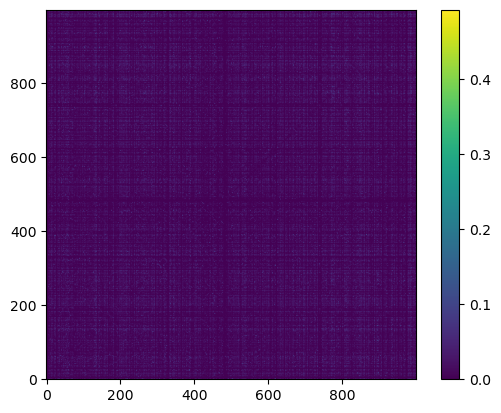

In [60]:
plt.imshow(sscp*(1-np.eye(sscp.shape[0])), origin='lower')
plt.colorbar()
plt.show()

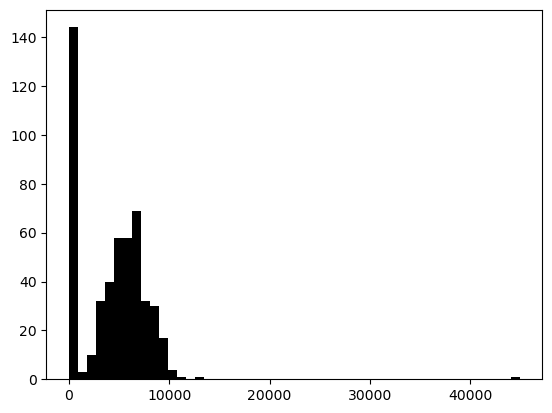

In [12]:
diag = np.diagonal(sscp)
plt.hist(diag, bins=50, color='black')
plt.show()

#### Covariance matrix

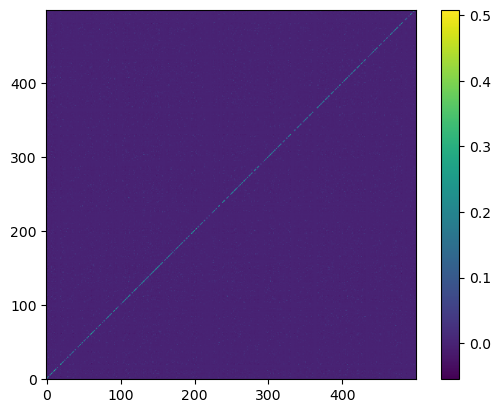

In [13]:
Cov = np.dot((embeddings-embeddings.mean(axis=0)).T, (embeddings-embeddings.mean(axis=0))) / (embeddings.shape[0]-1)
plt.imshow(Cov, origin='lower')
plt.colorbar()
plt.show()

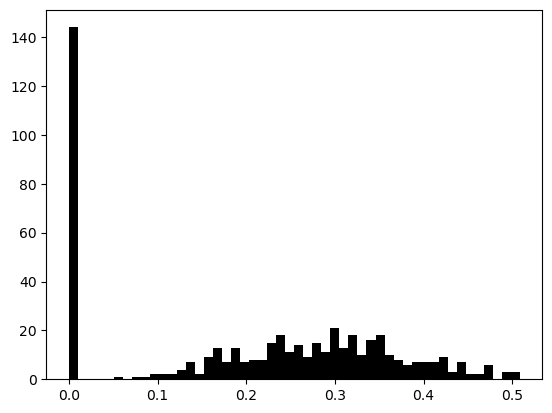

In [14]:
diag = np.diagonal(Cov)
plt.hist(diag, bins=50, color='black')
plt.show()

### Weight matrix hidden layer

In [20]:
#weights
W = model.fc1.weight.detach().cpu().numpy()
W_flatten = W.flatten()

In [21]:
W.shape

(500, 6400)

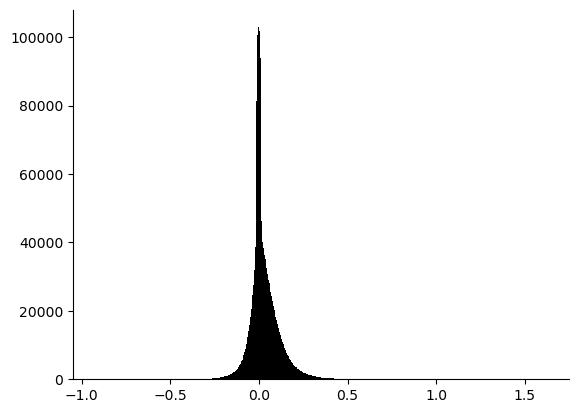

In [22]:
plt.hist(W_flatten, bins=1000, color='black')
sb.despine()
plt.show()

In [23]:
print( np.mean(W_flatten), np.std(W_flatten), np.mean(W_flatten)/np.std(W_flatten) )

0.028307762 0.08392518 0.3372976


In [24]:
np.linalg.matrix_rank(W.T)

500

In [25]:
print( intrinsic_dimensionality(W.T, method='PCA') )

9


In [26]:
indxs_active = np.any(embeddings, axis=0)
W_clean = W[indxs_active, :]
sim_W_clean = np.dot(W_clean, W_clean.T)*(1-np.eye(W_clean.shape[0]))

In [27]:
sim_W_clean.shape

(403, 403)

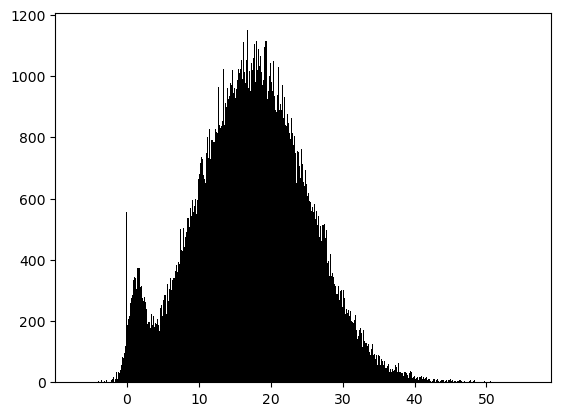

In [29]:
plt.hist(sim_W_clean.flatten(), color='black', bins=500)
plt.show()

In [31]:
sim_W_clean.mean()

17.31147024143299

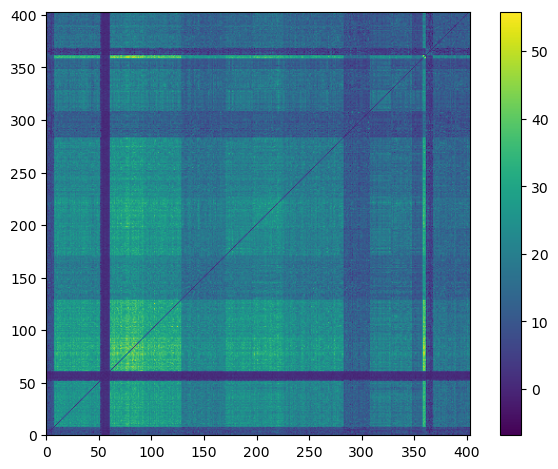

In [32]:
clustering = AffinityPropagation().fit(sim_W_clean)
plot_similarity_matrix_clustered(sim_W_clean, clustering.labels_)

In [33]:
# get neuron indxs of each cluster. plot decoded images per cluster and check similarity within vs between clusters. DONE
# check also the place fields centroids' distances within vs between clusters.
# neurons are encoding for similar things! (images are in general similar, but vary in details)
# for non-ortho, neurons encode for disentangled features, with a low-dimensional manifold spanning the original input space.

In [34]:
active_neurons_indx = np.arange(W.shape[0])[indxs_active]
cluster_labels = clustering.labels_
n_clusters = np.unique(cluster_labels).size

In [35]:
sorted_data = sorted(zip(active_neurons_indx, cluster_labels), key=lambda x: x[1])
sorted_neurons_indx, sorted_cluster_labels = zip(*sorted_data)
sorted_neurons_indx = np.array(sorted_neurons_indx)
sorted_cluster_labels = np.array(sorted_cluster_labels)

PCA in weight space

In [241]:
W_reduced = PCA().fit(W_clean.T)
variances_W = W_reduced.explained_variance_ratio_
cum_variances_W = np.cumsum(variances_W)

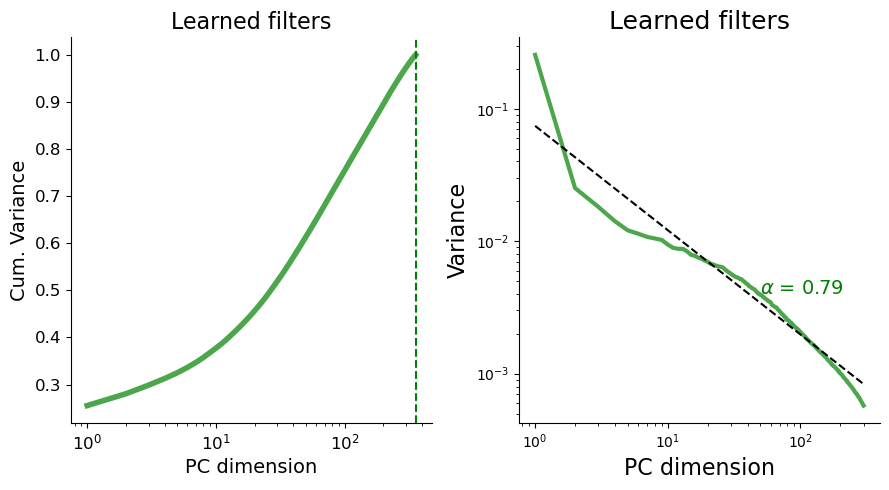

In [253]:
plt.figure(figsize=(9,5))

plt.subplot(121)
plt.plot(np.arange(1, cum_variances_W.size+1), cum_variances_W, color='green', linewidth=4, alpha=0.7)

plt.title('Learned filters', fontsize=16)

plt.axvline(x=W_clean.shape[0], linestyle='--', color='green')

plt.xlabel('PC dimension', fontsize=14)
plt.ylabel('Cum. Variance', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xscale('log')

sb.despine()

plt.subplot(122)

plt.title('Learned filters', fontsize=18)

cutoff_dim = 300
cutoff_fit = 200

x = np.arange(1, cutoff_dim+1)
y = variances_W[:cutoff_dim]

plt.plot(x, y, color='green', linewidth=3, alpha=0.7)

#plt.vlines(x=1e3, ymin=1e-3, ymax=6e-3, color='black', linewidth=3, linestyle='--')

m, b = np.polyfit(np.log(x[:cutoff_fit]), np.log(y[:cutoff_fit]), 1)
#plt.plot(np.exp(x), np.exp(m*x+b), linestyle='--', color='black', linewidth=1.5)

x_fit = np.linspace(min(x[:cutoff_dim]), max(x[:cutoff_dim]), 100)
y_fit = np.exp(b) * x_fit**m
plt.plot(x_fit, y_fit, linestyle='--', color='black', linewidth=1.5)

plt.text(x=50, y=4e-3, s='$\u03B1$ = '+str(np.around(-m, 2)), color='green', fontsize=14)

plt.xlabel('PC dimension', fontsize=16)
plt.ylabel('Variance', fontsize=16)
plt.xscale('log')
plt.yscale('log')
#plt.xlim(1, 1e3)
#plt.ylim(1e-4, 3e-1)

sb.despine()

plt.tight_layout()
plt.show()

## Feature images

In [36]:
features = extract_feature_images(model, embeddings, clamping_value=6)

In [37]:
features.shape

(500, 84, 84, 3)

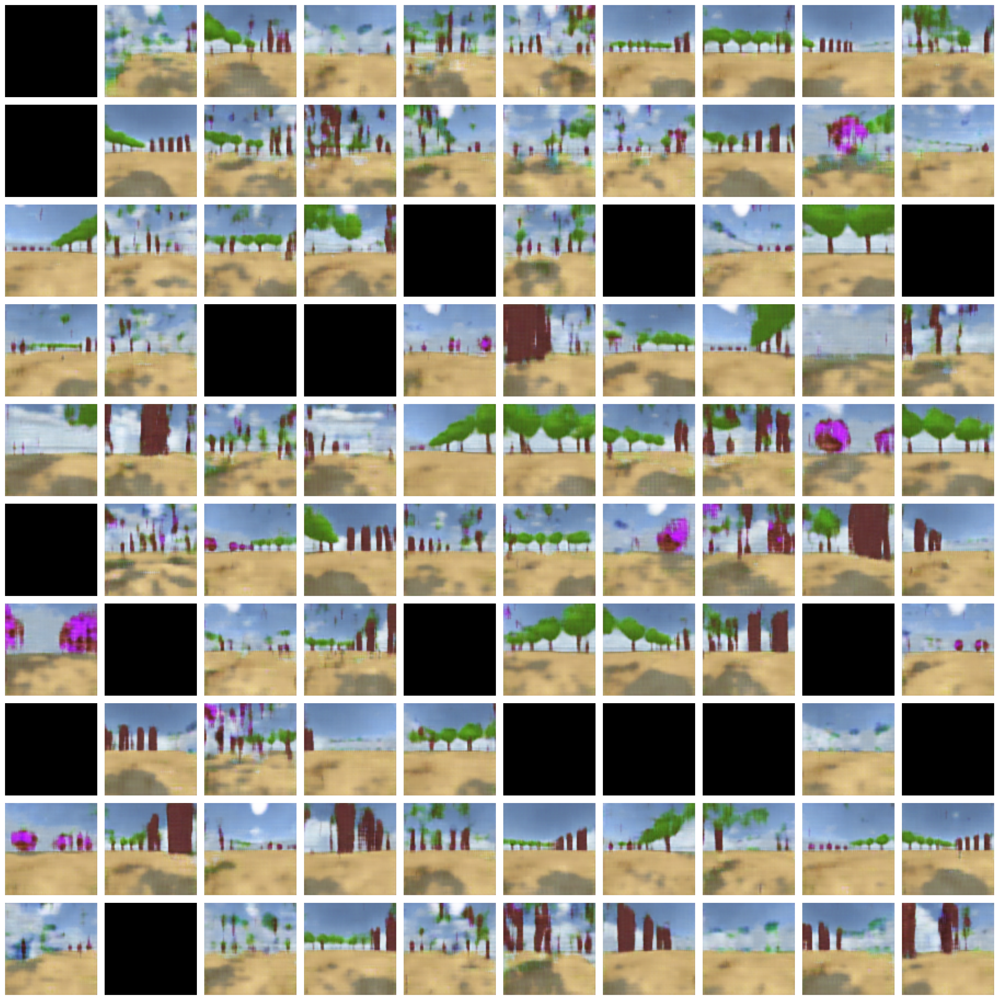

In [38]:
plt.figure(figsize=(20,20), dpi=300)
for i in range(100):
    plt.subplot(10, 10, i+1)
    plt.imshow(features[i], interpolation='bilinear')
    plt.axis('off')
plt.tight_layout()
plt.savefig('plots/feature_images.png', dpi=600)
plt.show()

In [39]:
imgs_clusters = []
for cluster_id in np.unique(sorted_cluster_labels):
    neurons_indx_cluster = sorted_neurons_indx[cluster_id==sorted_cluster_labels]
    imgs_clusters.append(features[neurons_indx_cluster])

In [40]:
dist_matrix = np.zeros((n_clusters, n_clusters))
for i in np.arange(len(imgs_clusters)):
    for j in np.arange(i, len(imgs_clusters)):
        dists = []
        for img_1 in imgs_clusters[i]:
            for img_2 in imgs_clusters[j]:
                dists.append(euclidean_distance(img_1.flatten(), img_2.flatten()))
        mean_dist = np.mean(dists)
        dist_matrix[i,j] = -mean_dist
        dist_matrix[j,i] = -mean_dist

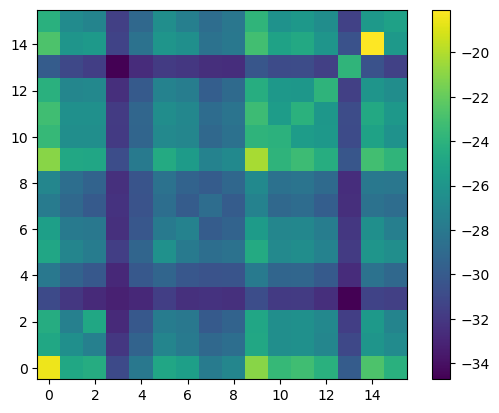

In [41]:
plt.imshow(dist_matrix, origin='lower')
plt.colorbar()

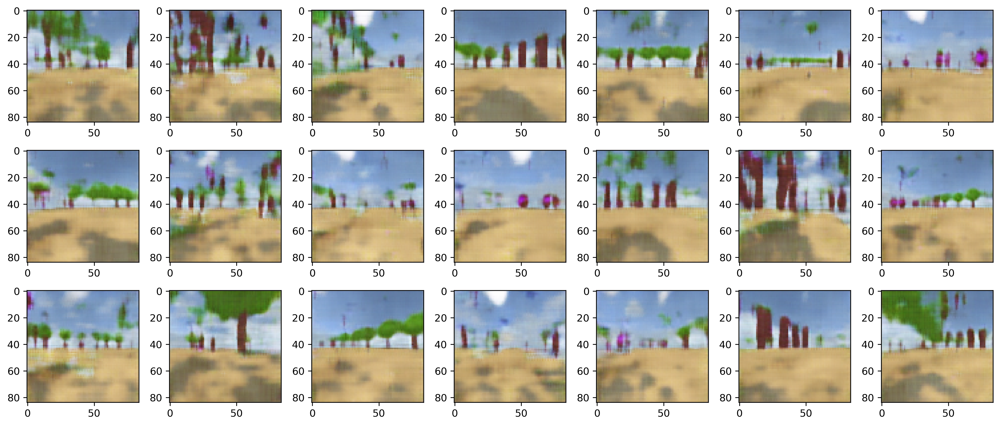

In [42]:
plt.figure(figsize=(14,6), dpi=300)
for i in range(21):
    plt.subplot(3,7,i+1)
    plt.imshow(imgs_clusters[1][i])
plt.tight_layout()
plt.show()

Images in clusters (by weight/filter similarity) do not seem to be similar

In [43]:
indxs_active = np.any(features, axis=(1,2,3))
features_clean = features[indxs_active]

In [44]:
dist_features = []
dist_W = []
for i in np.arange(features_clean.shape[0]):
    for j in np.arange(i+1, features_clean.shape[0]):
        dist_features.append( -euclidean_distance(features_clean[i], features_clean[j]) )
        dist_W.append( np.dot( W_clean[i, np.newaxis], W_clean[j, np.newaxis].T)[0,0] )

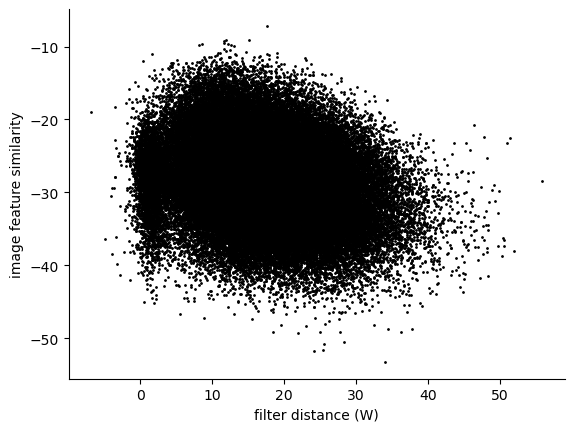

In [45]:
plt.scatter( dist_W, dist_features, color='black', alpha=1, s=1 )
plt.xlabel('filter distance (W)')
plt.ylabel('image feature similarity')
sb.despine()
plt.show()

Conclusion: similar filters (weight vectors) do not lead to similar decoded images (encoding features). Therefore, similarity across filters must capture generic image features. Probably they are learning non-overlapping details, and that's why there's no sense of similarity apart from the generic features encoded across all neurons.

## Intrinsic dimensionality of population activity

In [46]:
D = intrinsic_dimensionality(embeddings, method='PCA')

In [47]:
print(D)

377


In [48]:
print( clean_embeddings(embeddings).shape[1] )

403


In [49]:
np.linalg.matrix_rank(embeddings)

403

In [50]:
dim_collapse = 1 - ( np.linalg.matrix_rank(embeddings) / clean_embeddings(embeddings).shape[1] )
print(dim_collapse)

0.0


## Rate maps of single units

In [51]:
all_ratemaps = ratemaps(embeddings, position, n_bins=50, filter_width=3, occupancy_map=[], n_bins_padding=5)

In [52]:
plot_ratemaps(all_ratemaps[0:100])

In [53]:
plot_ratemaps(all_ratemaps[100:200])

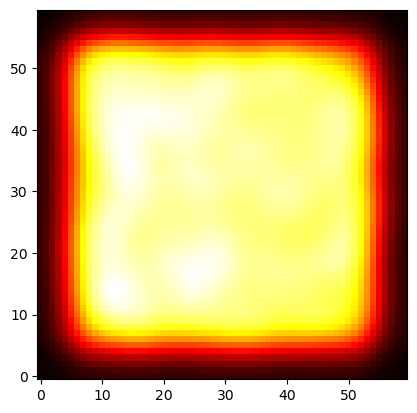

In [57]:
plt.imshow(np.sum(all_ratemaps, axis=0), cmap='hot', origin='lower')

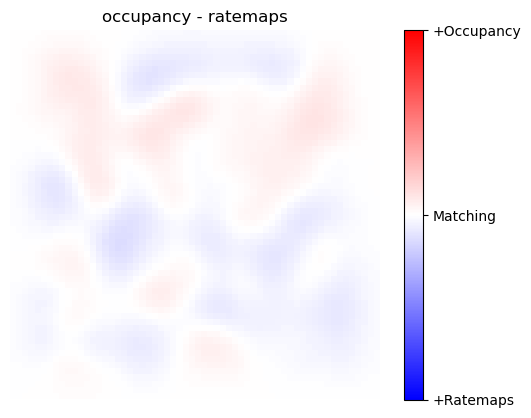

In [58]:
overall_ratemap = np.sum(all_ratemaps, axis=0).T
overall_ratemap = overall_ratemap/overall_ratemap.max()
map_diffs = occ_map - overall_ratemap
#min_ = np.min([map_diffs.min(), -map_diffs.max()])
#max_ = np.max([map_diffs.max(), -map_diffs.min()])
plt.imshow(map_diffs, cmap='bwr', origin='lower', vmin=-1, vmax=1)
plt.title('occupancy - ratemaps')
plt.axis('off')
cbar = plt.colorbar(ticks=[-1,0,1])
cbar.ax.set_yticklabels(['+Ratemaps', 'Matching', '+Occupancy']) 
plt.show()

In [59]:
degree_of_matching = np.round( np.sum(np.power(map_diffs, 2)) / np.count_nonzero(occ_map), 3)
print('MSE: ' + str(degree_of_matching))

MSE: 0.002


## Power law coding

#### Image eigenspectrum

In [234]:
from sklearn.decomposition import PCA

In [81]:
dataset_reduced = PCA().fit(dataset.reshape((dataset.shape[0], int(84*84*3))))
variances_dataset = dataset_reduced.explained_variance_ratio_
cum_variances_dataset = np.cumsum(variances_dataset)

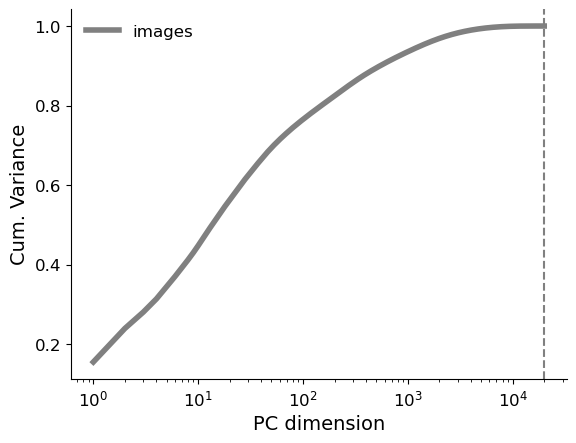

In [82]:
plt.plot(np.arange(1, cum_variances_dataset.size+1), cum_variances_dataset, color='gray', linewidth=4, label='images')

plt.axvline(x=dataset.shape[0], linestyle='--', color='gray')

plt.xlabel('PC dimension', fontsize=14)
plt.ylabel('Cum. Variance', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xscale('log')

plt.legend(fontsize=12, frameon=False)

sb.despine()
plt.show()

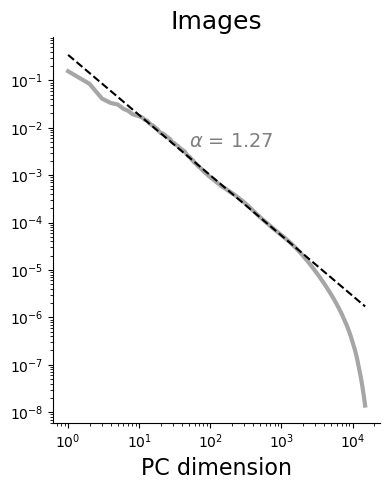

In [83]:
plt.figure(figsize=(4,5))

plt.title('Images', fontsize=18)

cutoff_dim = 15000
cutoff_fit = 2000

x = np.arange(1, cutoff_dim+1)
y = variances_dataset[:cutoff_dim]

plt.plot(x, y, color='gray', linewidth=3, alpha=0.7)

#plt.vlines(x=1e3, ymin=1e-3, ymax=6e-3, color='black', linewidth=3, linestyle='--')

m, b = np.polyfit(np.log(x[:cutoff_fit]), np.log(y[:cutoff_fit]), 1)
#plt.plot(np.exp(x), np.exp(m*x+b), linestyle='--', color='black', linewidth=1.5)

x_fit = np.linspace(min(x[:cutoff_dim]), max(x[:cutoff_dim]), 100)
y_fit = np.exp(b) * x_fit**m
plt.plot(x_fit, y_fit, linestyle='--', color='black', linewidth=1.5)

plt.text(x=50, y=4e-3, s='$\u03B1$ = '+str(np.around(-m, 2)), color='gray', fontsize=14)

plt.xlabel('PC dimension', fontsize=16)
#plt.ylabel('Variance', fontsize=16)
plt.xscale('log')
plt.yscale('log')
#plt.xlim(1, 1e3)
#plt.ylim(1e-4, 3e-1)

sb.despine()

plt.tight_layout()
plt.show()

#### Neural eigenspectrum

In [85]:
model_ortho = Conv_AE(n_hidden=1000).to('cuda')
model_ortho.load_state_dict(torch.load('saved_models/AE_ortho.pth'))

model_nonortho = Conv_AE(n_hidden=1000).to('cuda')
model_nonortho.load_state_dict(torch.load('saved_models/AE_non-ortho.pth'))

<All keys matched successfully>

In [86]:
embeddings_ortho = get_latent_vectors(dataset, model_ortho)
embeddings_nonortho = get_latent_vectors(dataset, model_nonortho)

In [87]:
embeddings_ortho_reduced = PCA().fit(embeddings_ortho)
variances_ortho = embeddings_ortho_reduced.explained_variance_ratio_
cum_variances_ortho = np.cumsum(variances_ortho)

embeddings_nonortho_reduced = PCA().fit(embeddings_nonortho)
variances_nonortho = embeddings_nonortho_reduced.explained_variance_ratio_
cum_variances_nonortho = np.cumsum(variances_nonortho)

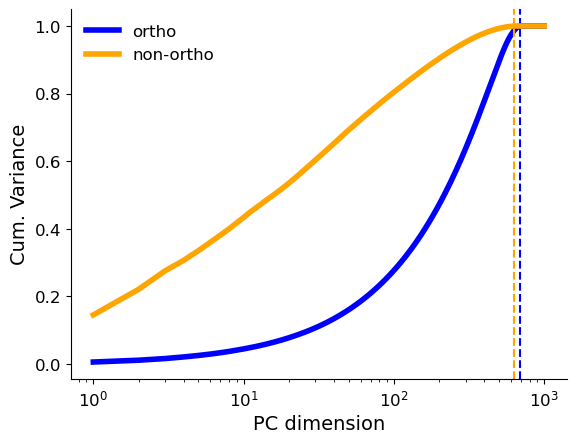

In [88]:
plt.plot(np.arange(1, cum_variances_ortho.size+1), cum_variances_ortho, color='blue', linewidth=4, label='ortho')

active_neurons = clean_embeddings(embeddings_ortho).shape[1]
plt.axvline(x=active_neurons, linestyle='--', color='blue')


plt.plot(np.arange(1, cum_variances_nonortho.size+1), cum_variances_nonortho, color='orange', linewidth=4, label='non-ortho')

active_neurons = clean_embeddings(embeddings_nonortho).shape[1]
plt.axvline(x=active_neurons, linestyle='--', color='orange')

plt.xlabel('PC dimension', fontsize=14)
plt.ylabel('Cum. Variance', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xscale('log')

plt.legend(fontsize=12, frameon=False)

sb.despine()
plt.show()

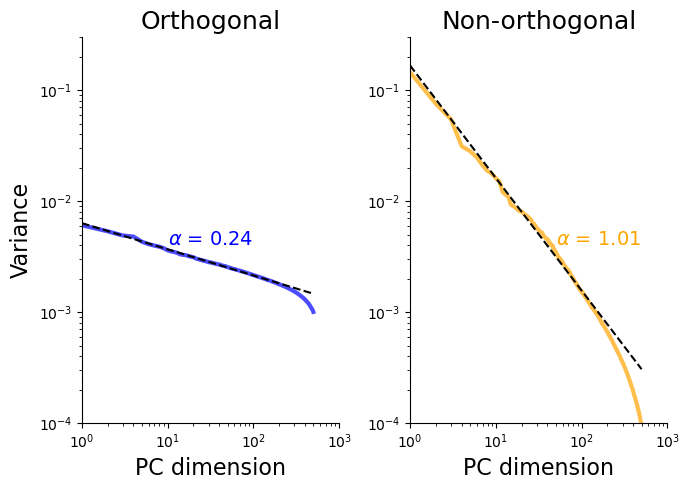

In [89]:
plt.figure(figsize=(7,5))


plt.subplot(121)

plt.title('Orthogonal', fontsize=18)

cutoff_dim = 500
cutoff_fit = 200

x = np.arange(1, cutoff_dim+1)
y = variances_ortho[:cutoff_dim]

plt.plot(x, y, color='blue', linewidth=3, alpha=0.7)

#plt.vlines(x=1e3, ymin=1e-3, ymax=6e-3, color='black', linewidth=3, linestyle='--')

m, b = np.polyfit(np.log(x[:cutoff_fit]), np.log(y[:cutoff_fit]), 1)
#plt.plot(np.exp(x), np.exp(m*x+b), linestyle='--', color='black', linewidth=1.5)

x_fit = np.linspace(min(x[:cutoff_dim]), max(x[:cutoff_dim]), 100)
y_fit = np.exp(b) * x_fit**m
plt.plot(x_fit, y_fit, linestyle='--', color='black', linewidth=1.5)

plt.text(x=10, y=4e-3, s='$\u03B1$ = '+str(np.around(-m, 2)), color='blue', fontsize=14)

plt.xlabel('PC dimension', fontsize=16)
plt.ylabel('Variance', fontsize=16)
plt.xscale('log')
plt.yscale('log')
plt.xlim(1, 1e3)
plt.ylim(1e-4, 3e-1)

sb.despine()



plt.subplot(122)

plt.title('Non-orthogonal', fontsize=18)

cutoff_dim = 500
cutoff_fit = 150

x = np.arange(1, cutoff_dim+1)
y = variances_nonortho[:cutoff_dim]

plt.plot(x, y, color='orange', linewidth=3, alpha=0.7)

#plt.vlines(x=1e3, ymin=1e-3, ymax=6e-3, color='black', linewidth=3, linestyle='--')

m, b = np.polyfit(np.log(x[:cutoff_fit]), np.log(y[:cutoff_fit]), 1)
#plt.plot(np.exp(x), np.exp(m*x+b), linestyle='--', color='black', linewidth=1.5)

x_fit = np.linspace(min(x[:cutoff_dim]), max(x[:cutoff_dim]), 100)
y_fit = np.exp(b) * x_fit**m
plt.plot(x_fit, y_fit, linestyle='--', color='black', linewidth=1.5)

plt.text(x=50, y=4e-3, s='$\u03B1$ = '+str(np.around(-m, 2)), color='orange', fontsize=14)

plt.xlabel('PC dimension', fontsize=16)
#plt.ylabel('Variance', fontsize=16)
plt.xscale('log')
plt.yscale('log')
plt.xlim(1, 1e3)
plt.ylim(1e-4, 3e-1)

sb.despine()

plt.tight_layout()
plt.show()

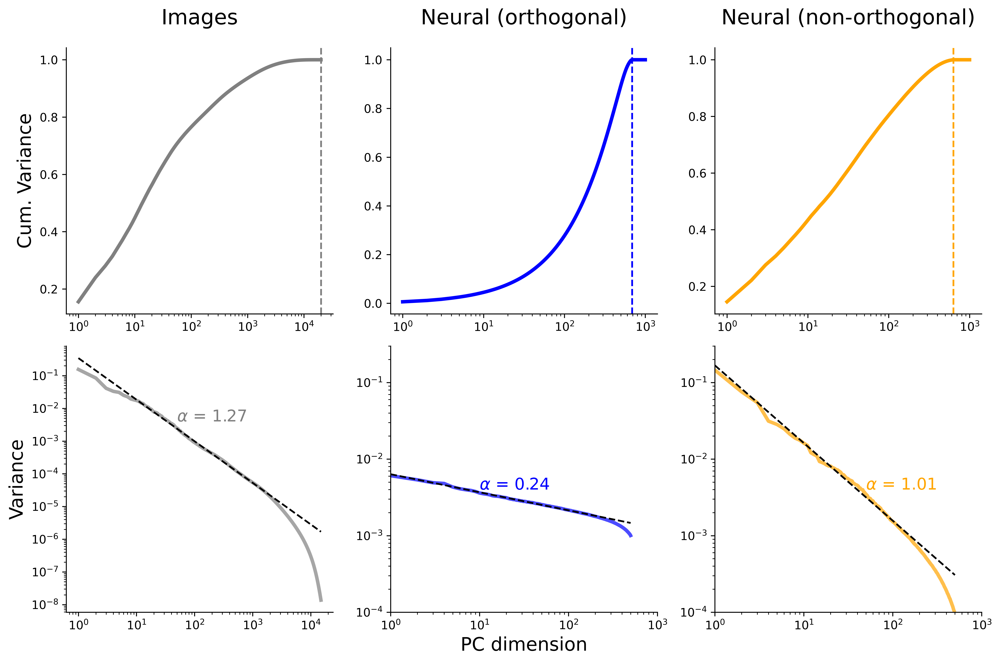

In [92]:
plt.figure(figsize=(12,8), dpi=600)



plt.subplot(231)

plt.title('Images', fontsize=18, pad=20)

plt.plot(np.arange(1, cum_variances_dataset.size+1), cum_variances_dataset, color='gray', linewidth=3, label='images')

plt.axvline(x=dataset.shape[0], linestyle='--', color='gray')

plt.ylabel('Cum. Variance', fontsize=16)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xscale('log')

sb.despine()



plt.subplot(232)

plt.title('Neural (orthogonal)', fontsize=18, pad=20)

plt.plot(np.arange(1, cum_variances_ortho.size+1), cum_variances_ortho, color='blue', linewidth=3, label='ortho')

active_neurons = clean_embeddings(embeddings_ortho).shape[1]
plt.axvline(x=active_neurons, linestyle='--', color='blue')

plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xscale('log')

sb.despine()



plt.subplot(233)

plt.title('Neural (non-orthogonal)', fontsize=18, pad=20)

plt.plot(np.arange(1, cum_variances_nonortho.size+1), cum_variances_nonortho, color='orange', linewidth=3, label='non-ortho')

active_neurons = clean_embeddings(embeddings_nonortho).shape[1]
plt.axvline(x=active_neurons, linestyle='--', color='orange')

plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.xscale('log')

sb.despine()




plt.subplot(234)


cutoff_dim = 15000
cutoff_fit = 2000

x = np.arange(1, cutoff_dim+1)
y = variances_dataset[:cutoff_dim]

plt.plot(x, y, color='gray', linewidth=3, alpha=0.7)

#plt.vlines(x=1e3, ymin=1e-3, ymax=6e-3, color='black', linewidth=3, linestyle='--')

m, b = np.polyfit(np.log(x[:cutoff_fit]), np.log(y[:cutoff_fit]), 1)
#plt.plot(np.exp(x), np.exp(m*x+b), linestyle='--', color='black', linewidth=1.5)

x_fit = np.linspace(min(x[:cutoff_dim]), max(x[:cutoff_dim]), 100)
y_fit = np.exp(b) * x_fit**m
plt.plot(x_fit, y_fit, linestyle='--', color='black', linewidth=1.5)

plt.text(x=50, y=4e-3, s='$\u03B1$ = '+str(np.around(-m, 2)), color='gray', fontsize=14)

plt.ylabel('Variance', fontsize=16)
plt.xscale('log')
plt.yscale('log')
#plt.xlim(1, 1e3)
#plt.ylim(1e-4, 3e-1)

sb.despine()

plt.tight_layout()




plt.subplot(235)


cutoff_dim = 500
cutoff_fit = 200

x = np.arange(1, cutoff_dim+1)
y = variances_ortho[:cutoff_dim]

plt.plot(x, y, color='blue', linewidth=3, alpha=0.7)

#plt.vlines(x=1e3, ymin=1e-3, ymax=6e-3, color='black', linewidth=3, linestyle='--')

m, b = np.polyfit(np.log(x[:cutoff_fit]), np.log(y[:cutoff_fit]), 1)
#plt.plot(np.exp(x), np.exp(m*x+b), linestyle='--', color='black', linewidth=1.5)

x_fit = np.linspace(min(x[:cutoff_dim]), max(x[:cutoff_dim]), 100)
y_fit = np.exp(b) * x_fit**m
plt.plot(x_fit, y_fit, linestyle='--', color='black', linewidth=1.5)

plt.text(x=10, y=4e-3, s='$\u03B1$ = '+str(np.around(-m, 2)), color='blue', fontsize=14)

plt.xlabel('PC dimension', fontsize=16)
plt.xscale('log')
plt.yscale('log')
plt.xlim(1, 1e3)
plt.ylim(1e-4, 3e-1)

sb.despine()




plt.subplot(236)

cutoff_dim = 500
cutoff_fit = 150

x = np.arange(1, cutoff_dim+1)
y = variances_nonortho[:cutoff_dim]

plt.plot(x, y, color='orange', linewidth=3, alpha=0.7)

#plt.vlines(x=1e3, ymin=1e-3, ymax=6e-3, color='black', linewidth=3, linestyle='--')

m, b = np.polyfit(np.log(x[:cutoff_fit]), np.log(y[:cutoff_fit]), 1)
#plt.plot(np.exp(x), np.exp(m*x+b), linestyle='--', color='black', linewidth=1.5)

x_fit = np.linspace(min(x[:cutoff_dim]), max(x[:cutoff_dim]), 100)
y_fit = np.exp(b) * x_fit**m
plt.plot(x_fit, y_fit, linestyle='--', color='black', linewidth=1.5)

plt.text(x=50, y=4e-3, s='$\u03B1$ = '+str(np.around(-m, 2)), color='orange', fontsize=14)

#plt.ylabel('Variance', fontsize=16)
plt.xscale('log')
plt.yscale('log')
plt.xlim(1, 1e3)
plt.ylim(1e-4, 3e-1)

sb.despine()




plt.tight_layout()

plt.savefig('plots/powerlaw.png', dpi=600)

plt.show()

In [8]:
whitened_images = image_whitening(dataset)

In [9]:
whitened_dataset_reduced = PCA().fit(whitened_images.reshape((whitened_images.shape[0], int(84*84*3))))
variances_whitened_dataset = whitened_dataset_reduced.explained_variance_ratio_
cum_variances_whitened_dataset = np.cumsum(variances_whitened_dataset)


KeyboardInterrupt



In [ ]:
plt.plot(np.arange(1, cum_variances_whitened_dataset.size+1), cum_variances_whitened_dataset, color='gray', linewidth=4, label='images')

plt.axvline(x=whitened_images.shape[0], linestyle='--', color='gray')

plt.xlabel('PC dimension', fontsize=14)
plt.ylabel('Cum. Variance', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)

plt.legend(fontsize=12, frameon=False)

sb.despine()
plt.show()

In [ ]:
plt.figure(figsize=(4,5))

plt.title('Whitened images', fontsize=18)

cutoff_dim = 15000
cutoff_fit = 2000

x = np.arange(1, cutoff_dim+1)
y = variances_whitened_dataset[:cutoff_dim]

plt.plot(x, y, color='gray', linewidth=3, alpha=0.7)

#plt.vlines(x=1e3, ymin=1e-3, ymax=6e-3, color='black', linewidth=3, linestyle='--')

m, b = np.polyfit(np.log(x[:cutoff_fit]), np.log(y[:cutoff_fit]), 1)
#plt.plot(np.exp(x), np.exp(m*x+b), linestyle='--', color='black', linewidth=1.5)

x_fit = np.linspace(min(x[:cutoff_dim]), max(x[:cutoff_dim]), 100)
y_fit = np.exp(b) * x_fit**m
plt.plot(x_fit, y_fit, linestyle='--', color='black', linewidth=1.5)

plt.text(x=50, y=4e-3, s='$\u03B1$ = '+str(np.around(-m, 2)), color='gray', fontsize=14)

plt.xlabel('PC dimension', fontsize=16)
#plt.ylabel('Variance', fontsize=16)
plt.xscale('log')
plt.yscale('log')
#plt.xlim(1, 1e3)
#plt.ylim(1e-4, 3e-1)

sb.despine()

plt.tight_layout()
plt.show()

## Population sparseness

In [53]:
all_ratemaps_thres = np.copy(all_ratemaps)
active_thres = 0.2
all_ratemaps_thres[all_ratemaps_thres<active_thres] = 0
all_ratemaps_thres[all_ratemaps_thres>=active_thres] = 1

In [54]:
all_ratemaps_thres_avg = np.mean(all_ratemaps_thres, axis=0)

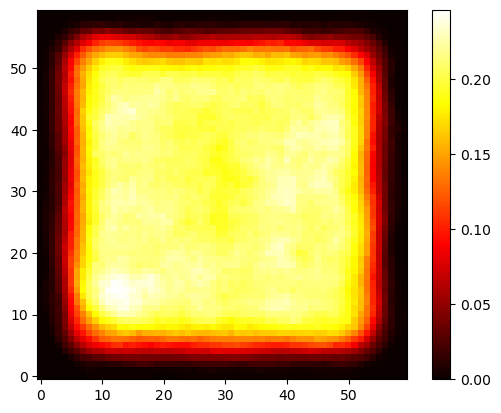

In [55]:
plt.imshow(all_ratemaps_thres_avg, origin='lower', cmap='hot')
plt.colorbar()

In [56]:
pop_sparseness = np.mean(all_ratemaps_thres_avg)

In [57]:
print(pop_sparseness)

0.13736638888888889


(0.0, 8000.0)

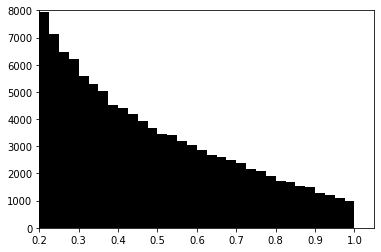

In [29]:
plt.hist(all_ratemaps.flatten(), bins=40, color='black')
plt.xlim(active_thres)
plt.ylim(0,8000)

In [58]:
# Population sparseness based on embeddings, instead of filtered ratemaps
print( unit_sparseness(embeddings).round(3), '%' )

0.019 %


## Place field distribution

In [186]:
n_fields, centroids, sizes = stats_place_fields(clean_ratemaps(all_ratemaps), peak_as_centroid=True, min_pix_cluster=0.05, 
                                                max_pix_cluster=0.5, active_threshold=0.2)

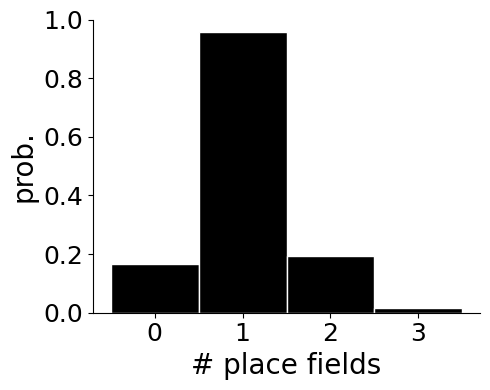

In [187]:
plot_place_field_hist(n_fields, save=True)

In [188]:
# proportion of active cells with at least one place field
prop_cells_with_place_fields(all_ratemaps, min_pix_cluster=0.02, max_pix_cluster=0.5, active_threshold=0.2)

0.8876404494382022

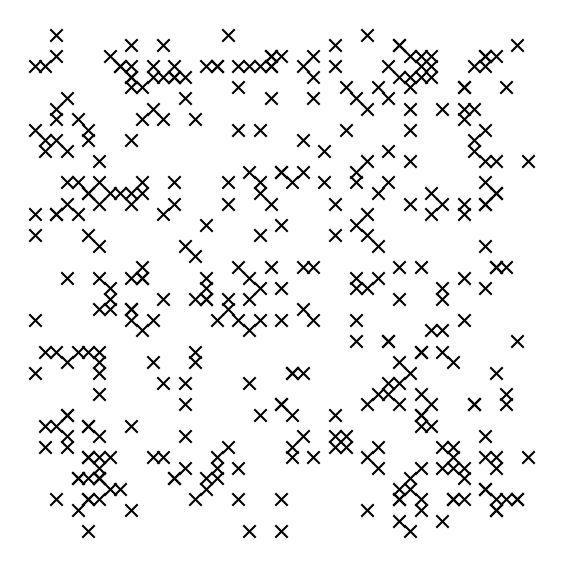

In [189]:
plt.figure(figsize=(6,6))

#plt.imshow(np.sum(all_ratemaps[:-1], axis=0), cmap='hot', origin='lower')
plt.scatter(centroids[:,0], centroids[:,1], color='black', marker='x', s=80)
#plt.axis('off')

plt.tight_layout()
plt.axis('off')

plt.savefig('plots/centroids.png', dpi=600, transparent=True)
plt.show()

In [190]:
print('Tiling homogeneity: ' + str(homogeneity_2Dtiling(centroids)))

Tiling homogeneity: 1.2984276501293082


## Spatial information

In [191]:
SI = spatial_information(clean_ratemaps(all_ratemaps), occ_map)

In [192]:
print(np.mean(SI))

1.710754868232413


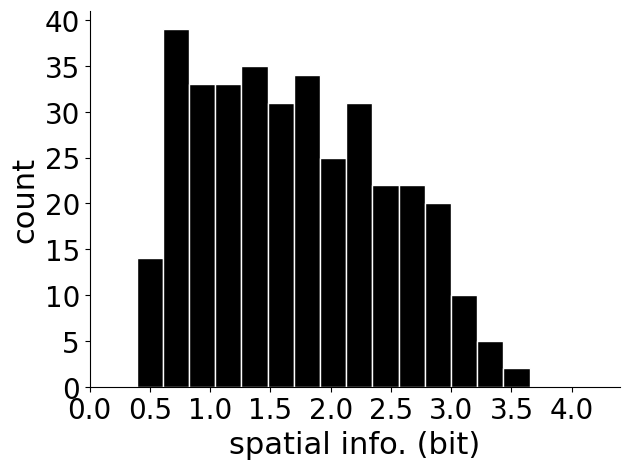

In [193]:
plt.hist(SI, color='black', bins=15, edgecolor='white')
plt.xlabel('spatial info. (bit)', fontsize=22)
plt.ylabel('count', fontsize=22)
plt.xlim(0,4.4)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
sb.despine()
plt.tight_layout()
plt.savefig('plots/spatial_info.png', dpi=600)
plt.show()

## Check whether centric place fields are also larger, i.e., if place fields close to the wall are smaller (and also more numerous) --> https://www.sciencedirect.com/science/article/pii/S0960982222010089 

In [194]:
dists_to_wall = dist_to_walls(centroids, occ_map)

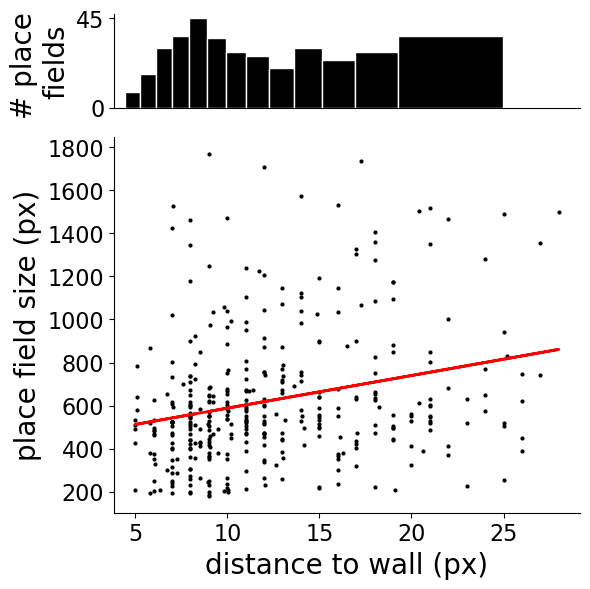

In [195]:
plot_distance_to_wall(dists_to_wall, sizes, norm_area=True, save=True)

## Check hyperbolic geometry, i.e., exponential distribution of field sizes, as in: https://www.nature.com/articles/s41593-022-01212-4 

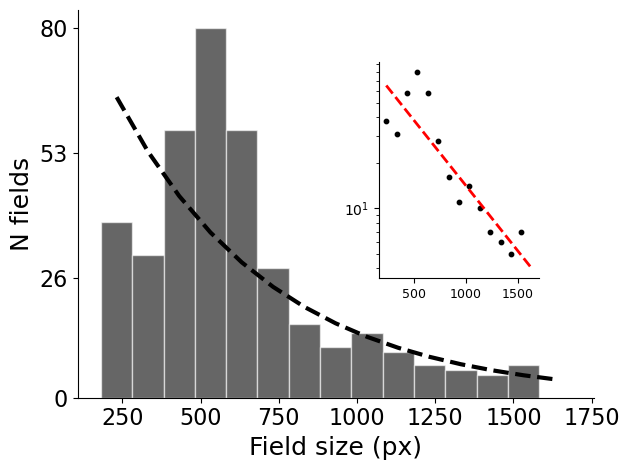

In [196]:
plot_hyperbolic_geometry(sizes, bin_width=100, save=True)

## Linear decoding of position

In [194]:
lin_score, baseline_score, ratio = linear_decoding_score(clean_embeddings(embeddings), position, n_baseline=10)

In [195]:
print('Linear decoder score: ' + str(lin_score))
print('Baseline avg.: ' + str(baseline_score[0]))
print('Ratio: ' + str(ratio))

Linear decoder score: 0.86703207489993
Baseline avg.: 0.03377688437167621
Ratio: 25.66939168690717


In [196]:
mean_error = linear_decoding_error(clean_embeddings(embeddings), position, norm=40)

In [197]:
print('Mean decoder error: ' + str(mean_error))

Mean decoder error: 0.09156641296640974


## Generalization

In [27]:
dataset_test = dataset_all[10000:, :]
position_test = position_all[10000:, :]

In [28]:
embeddings_test = get_latent_vectors(dataset_test, model)

In [30]:
linear_model = LinearRegression()
linear_model.fit(embeddings, position)
linear_score = linear_model.score(embeddings_test, position_test)

In [31]:
print('Linear decoder score (testing): ' + str(linear_score))

Linear decoder score (testing): 0.5736881301397223


## Representational drift

In [9]:
embeddings_epoch.shape

(1001, 20000, 200)

In [10]:
start = 300
end = embeddings_epoch.shape[0]

linear_model = LinearRegression()
linear_model.fit(embeddings_epoch[start], position)

test_scores = []
test_errors = []
test_latent_dist = []
pv_corr = []
for i in range(start, end):
    linear_score = linear_model.score(embeddings_epoch[i], position)
    test_scores.append(linear_score)
    
    pred = linear_model.predict(embeddings_epoch[i])
    dist = np.sqrt(np.sum((pred - position)**2, axis=1))
    mean_dist = np.mean(dist)
    test_errors.append(mean_dist)
    
    latent_vec_dist = []
    for _ in range(1000):
        indx = np.random.choice(np.arange(embeddings_epoch.shape[1]), 1, replace=False)
        latent_vec_dist.append( euclidean_distance(embeddings_epoch[start, indx], embeddings_epoch[i, indx]) )
    test_latent_dist.append( np.mean(latent_vec_dist) )
    
    pv = pv_correlation( embeddings_epoch[start], embeddings_epoch[i], position )
    pv_corr.append(pv)

In [22]:
pv_corr = []
for i in range(start, end):
    pv = pv_correlation( embeddings_epoch[start], embeddings_epoch[i], position )
    pv_corr.append(pv)

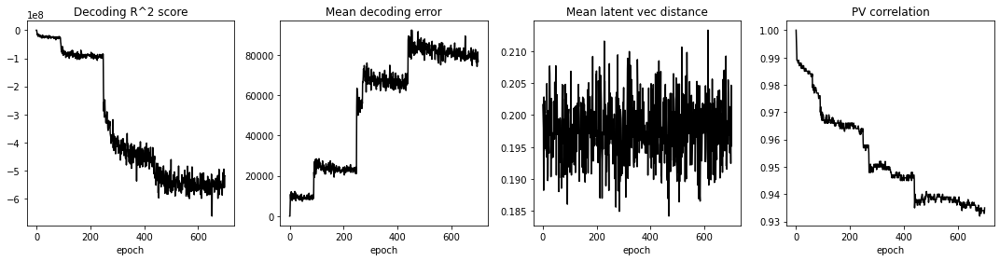

In [24]:
plt.figure(figsize=(15,4))

plt.subplot(141)
plt.title('Decoding R^2 score')
plt.plot(test_scores, color='black')
plt.xlabel('epoch')

plt.subplot(142)
plt.title('Mean decoding error')
plt.plot(test_errors, color='black')
plt.xlabel('epoch')

plt.subplot(143)
plt.title('Mean latent vec distance')
plt.plot(test_latent_dist, color='black')
plt.xlabel('epoch')

plt.subplot(144)
plt.title('PV correlation')
plt.plot(pv_corr, color='black')
plt.xlabel('epoch')
#plt.ylim(0,1)

plt.tight_layout()
plt.show()

## Correlation between image distance and latent vector distance

In [200]:
model_ortho = Conv_AE(n_hidden=1000).to('cuda')
model_ortho.load_state_dict(torch.load('saved_models/AE_ortho.pth'))

model_nonortho = Conv_AE(n_hidden=1000).to('cuda')
model_nonortho.load_state_dict(torch.load('saved_models/AE_non-ortho.pth'))

embeddings_ortho = get_latent_vectors(dataset, model_ortho)
embeddings_nonortho = get_latent_vectors(dataset, model_nonortho)

In [201]:
n_exp = 1000000

spatial_pos_dist = []
latent_vec_dist_ortho = []
latent_vec_dist_nonortho = []
for i in range(n_exp):
    ind_1, ind_2 = np.random.choice(np.arange(dataset.shape[0]), 2, replace=False)
    spatial_pos_dist.append( euclidean_distance(dataset[ind_1], dataset[ind_2]) )
    latent_vec_dist_ortho.append( euclidean_distance(embeddings_ortho[ind_1], embeddings_ortho[ind_2]) )
    latent_vec_dist_nonortho.append( euclidean_distance(embeddings_nonortho[ind_1], embeddings_nonortho[ind_2]) )

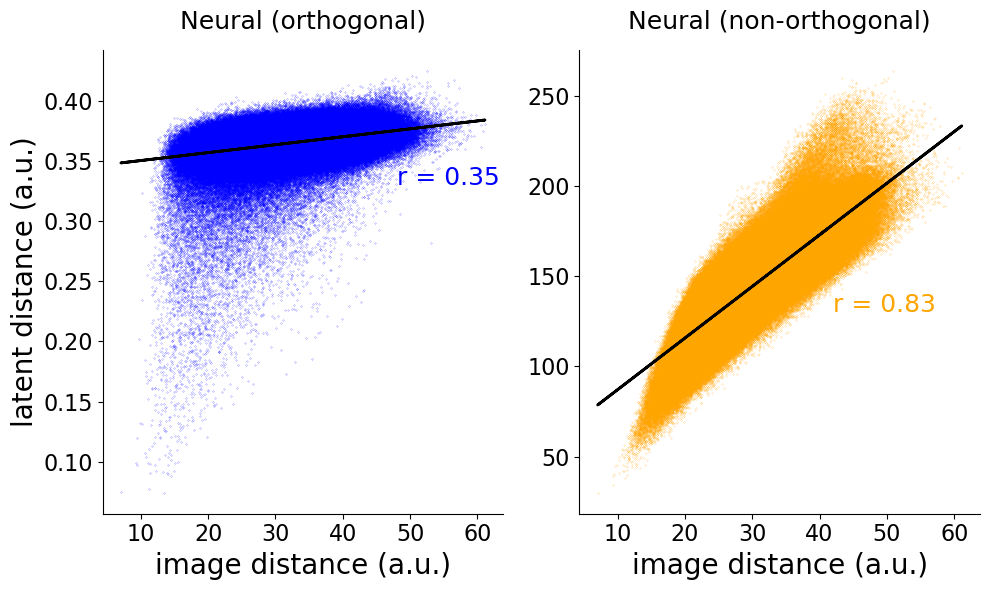

In [210]:
plt.figure(figsize=(10,6))

plt.subplot(121)

plt.title('Neural (orthogonal)', fontsize=18, pad=15)

plt.scatter(spatial_pos_dist, latent_vec_dist_ortho, s=.02, color='blue')
m,b = np.polyfit(spatial_pos_dist, latent_vec_dist_ortho, 1)
plt.plot(spatial_pos_dist, m*np.array(spatial_pos_dist)+b, linestyle='-', color='black', linewidth=2)
plt.text(48, 0.33, 'r = '+str(spearmanr( spatial_pos_dist, latent_vec_dist_ortho ).correlation.round(2)), fontsize=18, color='blue')
plt.ylabel('latent distance (a.u.)', fontsize=20)
plt.xlabel('image distance (a.u.)', fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
sb.despine()


plt.subplot(122)

plt.title('Neural (non-orthogonal)', fontsize=18, pad=15)

plt.scatter(spatial_pos_dist, latent_vec_dist_nonortho, s=.02, color='orange')
m,b = np.polyfit(spatial_pos_dist, latent_vec_dist_nonortho, 1)
plt.plot(spatial_pos_dist, m*np.array(spatial_pos_dist)+b, linestyle='-', color='black', linewidth=2)
plt.text(42, 130, 'r = '+str(spearmanr( spatial_pos_dist, latent_vec_dist_nonortho ).correlation.round(2)), fontsize=18, color='orange')
#plt.ylabel('latent distance', fontsize=20)
plt.xlabel('image distance (a.u.)', fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
sb.despine()


plt.tight_layout()

plt.savefig('plots/input-output-sim.png', dpi=600)

plt.show()

## Head direction cells

In [197]:
all_polarmaps = polarmaps(clean_embeddings(embeddings), orientation)

In [198]:
plot_polarmaps(all_polarmaps, n_cells_plot=30, save=True)

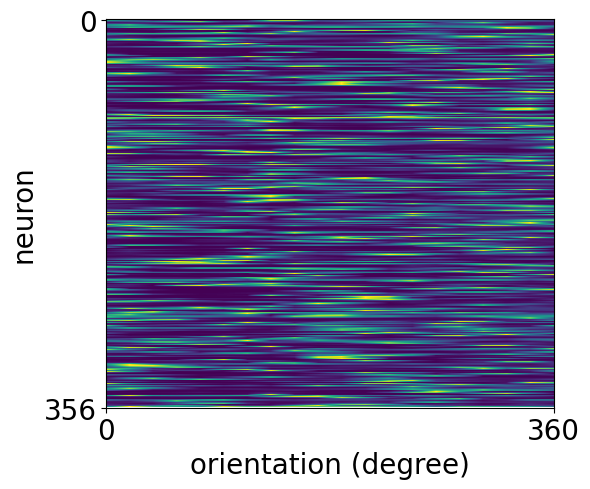

In [199]:
plt.figure(figsize=(6,5))
plt.imshow(all_polarmaps, aspect='auto', interpolation='bilinear')
plt.xticks([0, 19], [0, 360], fontsize=20)
plt.xlim(0,19)
plt.yticks([0, clean_embeddings(embeddings).shape[1]], [0, clean_embeddings(embeddings).shape[1]], fontsize=20)
plt.xlabel('orientation (degree)', fontsize=20)
plt.ylabel('neuron', fontsize=20)
plt.tight_layout()
plt.savefig('plots/angles.png', dpi=600)
plt.show()

In [200]:
allocentric_score = allocentricity(embeddings, orientation, n_bins=20)

In [201]:
print('Allocentric score: ' + str(allocentric_score))

Allocentric score: 0.3998917900229266


## Single unit contribution (ablation exp.)

In [ ]:
single_cell_lin_scores = []
for i in range(embeddings.shape[1]):
    ablated_embed = np.delete(embeddings, i, axis=1)
    score, b, r = linear_decoding_score(ablated_embed, position, n_baseline=1)
    single_cell_lin_scores.append(score)
score_full, b, r = linear_decoding_score(embeddings, position, n_baseline=1)
single_cell_contribs = score_full - np.array(single_cell_lin_scores)

In [ ]:
plt.figure(figsize=(16,4))
n_active = embeddings.shape[1]
plt.bar(np.arange(1, n_active+1), single_cell_contribs, color='black', alpha=1, width=1)
plt.xlabel('Cell #', fontsize=20)
plt.ylabel('Linear decoding contrib.', fontsize=20)
plt.yticks(fontsize=18)
plt.xticks(np.linspace(1, n_active, n_active+1, dtype=int), np.linspace(1, n_active, n_active+1, dtype=int), fontsize=18)
#plt.ylim(0,1)
sb.despine()
plt.show()

## Population coding (ablation exp.)

In [133]:
embeddings_clean = clean_embeddings(embeddings)
n_active = embeddings_clean.shape[1]

In [134]:
n_exp = 10
pop_lin_scores = np.zeros((n_active, n_exp))
for i in range(n_active):
    print(i)
    for j in range(n_exp):
        exclude = np.random.choice(np.arange(n_active), i, replace=False) 
        ablated_embed = np.delete(embeddings_clean, exclude, axis=1)
        lin_score, baseline_score, ratio = linear_decoding_score(ablated_embed, position, n_baseline=1)
        pop_lin_scores[i,j] = lin_score

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122


In [135]:
mean_pop_lin_scores = np.mean(pop_lin_scores, axis=1)
std_pop_lin_scores = np.std(pop_lin_scores, axis=1)

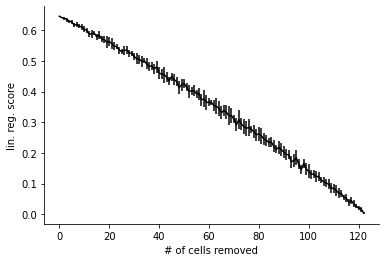

In [136]:
plt.errorbar(np.arange(n_active), mean_pop_lin_scores, yerr=std_pop_lin_scores, color='black')
plt.ylabel('lin. reg. score')
plt.xlabel('# of cells removed')
sb.despine()
plt.show()

## Control condition: shuffled hashes (permutation test)

In [143]:
embeddings_shuffled = shuffle_2D_matrix(np.copy(embeddings))

In [144]:
ratemaps_embeddings_shuffled = ratemaps(embeddings_shuffled, position, n_bins=50, filter_width=3)

In [145]:
plot_ratemaps(ratemaps_embeddings_shuffled)

In [146]:
n_fields_shuffled, centroids_shuffled, sizes_shuffled = stats_place_fields(ratemaps_embeddings_shuffled)

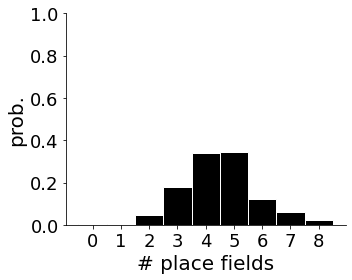

In [147]:
plot_place_field_hist(n_fields_shuffled)